### Importing the libraries

In [1]:
import pandas as pd
import numpy as np
import concurrent.futures
import torch
import cv2
import random
import ast
import sys
import requests
import os
import matplotlib.pyplot as plt
from PIL import ImageFile, Image
from io import BytesIO
from sklearn.cluster import KMeans
ImageFile.LOAD_TRUNCATED_IMAGES = True
os.environ["TOKENIZERS_PARALLELISM"] = "false"

### Creating the dataframe

In [2]:
data1 = pd.read_csv(
    '/media/hdd2/navaneeth/Deep-Learning-Projects/pytorch/color/color_bags.csv')
data2 = pd.read_csv(
    '/media/hdd2/navaneeth/Deep-Learning-Projects/pytorch/color/color_tops.csv')
data3 = pd.read_csv(
    '/media/hdd2/navaneeth/Deep-Learning-Projects/pytorch/color/color_pants.csv')

In [3]:
data = pd.concat([data1, data2, data3], ignore_index=True)
data = data[data['Category'].isin(['Bags', 'Pants', 'Tops'])]
data['Category_bbox'] = data['Category_bbox'].apply(
    lambda x: ast.literal_eval(x))

### Downloading the images from URL and saving

In [4]:
""" def download_image(url, file_name):
    r = requests.get(url, stream=True)
    if r.status_code == 200:
        print('Downloading ' + file_name)
        r.raw.decode_content = True
        with open(file_name, 'wb') as f:
            f.write(r.content)
        return file_name
    else:
        return None

with concurrent.futures.ThreadPoolExecutor() as executor:
    for i, row in data.iterrows():
        file_name = 'images/' + str(i) + '.jpg'
        url = row['image_url']
        executor.submit(download_image, url, file_name) """

" def download_image(url, file_name):\n    r = requests.get(url, stream=True)\n    if r.status_code == 200:\n        print('Downloading ' + file_name)\n        r.raw.decode_content = True\n        with open(file_name, 'wb') as f:\n            f.write(r.content)\n        return file_name\n    else:\n        return None\n\nwith concurrent.futures.ThreadPoolExecutor() as executor:\n    for i, row in data.iterrows():\n        file_name = 'images/' + str(i) + '.jpg'\n        url = row['image_url']\n        executor.submit(download_image, url, file_name) "

### Removing Unnecessary data from each dataset

In [5]:
""" data.drop(['image_url'], axis=1, inplace=True)
data.drop(['Category'], axis=1, inplace=True) """

" data.drop(['image_url'], axis=1, inplace=True)\ndata.drop(['Category'], axis=1, inplace=True) "

### Adding image data to the dataframes

In [6]:
def preprocess_image(file):
    img = cv2.imread(file)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


def preprocess_image_crop(file, labels_crops):
    img = cv2.imread(file)
    x1, y1, x2, y2 = int(labels_crops[0]), int(
        labels_crops[1]), int(labels_crops[2]), int(labels_crops[3])
    img = img[y1:y2, x1:x2]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


with concurrent.futures.ThreadPoolExecutor() as executor:
    for i, row in data.iterrows():
        file_name = 'images/' + str(i) + '.jpg'
        labels_crops = row['Category_bbox']
        data.at[i, 'image_data'] = executor.submit(
            preprocess_image, file_name)
        data.at[i, 'image_data_crop'] = executor.submit(
            preprocess_image_crop, file_name, labels_crops)

data['image_data'] = data['image_data'].apply(lambda x: x.result())
data['image_data_crop'] = data['image_data_crop'].apply(lambda x: x.result())

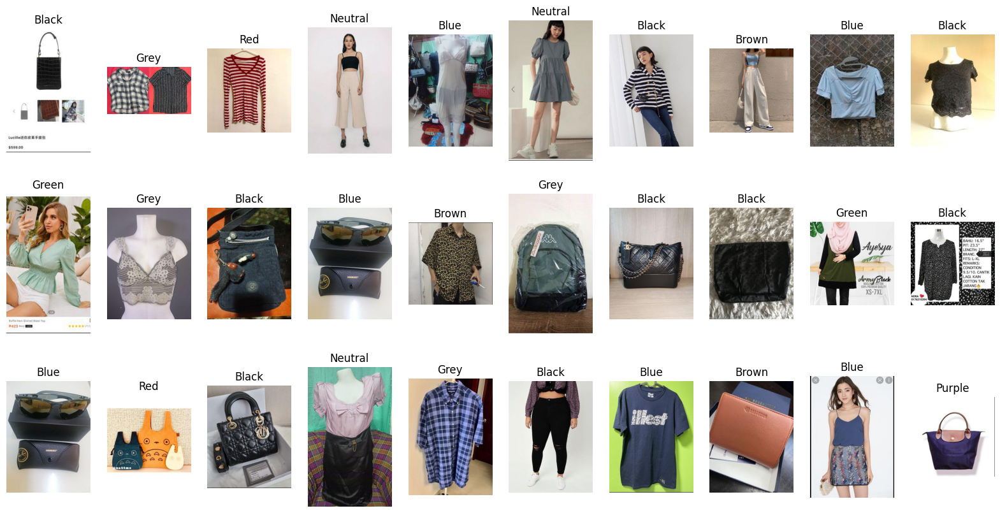

In [7]:
random.seed(31)
fig, ax = plt.subplots(3, 10, figsize=(20, 10))
for i in range(10):
    x = random.randint(0, len(data))
    y = random.randint(0, len(data))
    z = random.randint(0, len(data))
    img1 = data.iloc[x]['image_data']
    img2 = data.iloc[y]['image_data']
    img3 = data.iloc[z]['image_data']
    ax[0, i].imshow(img1)
    ax[0, i].set_title(data.iloc[x]['Base Color'])
    ax[1, i].imshow(img2)
    ax[1, i].set_title(data.iloc[y]['Base Color'])
    ax[2, i].imshow(img3)
    ax[2, i].set_title(data.iloc[z]['Base Color'])
    ax[0, i].axis('off')
    ax[1, i].axis('off')
    ax[2, i].axis('off')
plt.show()

### Plotting sample images of each dataset

### Image Processing 

#### Removing all unnecessary colors other than the Color HEX given in data

In [8]:
""" def remove_background(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, thresh = cv2.threshold(img, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(
        thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnt = contours[0]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = img[y:y+h, x:x+w]
    return crop

def patch(image):
    image1=image.reshape((image.shape[0]*image.shape[1],3))
    kmeans = KMeans(n_clusters=10, random_state=20, n_init=10).fit(image1)
    labels=kmeans.labels_
    counts=np.bincount(labels)
    colors=kmeans.cluster_centers_
    #plt.pie(counts,colors=colors/255,autopct='%1.1f%%')
    #plt.show()
    sorted_indices = np.argsort(counts)[::-1]
    sorted_colors = colors[sorted_indices]
    majority_color = sorted_colors[0]
    patch = np.zeros(shape=image.shape, dtype=np.uint8)
    patch[:,:,:]=majority_color
    return patch

image,label=data.iloc[571]['image_data_crop'],data.iloc[571]['Base Color']
plt.imshow(image)
plt.axis('off')
plt.show()
patch_color=patch(image)
plt.imshow(patch_color/255)
plt.axis('off')
plt.show() """

" def remove_background(img):\n    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)\n    _, thresh = cv2.threshold(img, 1, 255, cv2.THRESH_BINARY)\n    contours, _ = cv2.findContours(\n        thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)\n    cnt = contours[0]\n    x, y, w, h = cv2.boundingRect(cnt)\n    crop = img[y:y+h, x:x+w]\n    return crop\n\ndef patch(image):\n    image1=image.reshape((image.shape[0]*image.shape[1],3))\n    kmeans = KMeans(n_clusters=10, random_state=20, n_init=10).fit(image1)\n    labels=kmeans.labels_\n    counts=np.bincount(labels)\n    colors=kmeans.cluster_centers_\n    #plt.pie(counts,colors=colors/255,autopct='%1.1f%%')\n    #plt.show()\n    sorted_indices = np.argsort(counts)[::-1]\n    sorted_colors = colors[sorted_indices]\n    majority_color = sorted_colors[0]\n    patch = np.zeros(shape=image.shape, dtype=np.uint8)\n    patch[:,:,:]=majority_color\n    return patch\n\nimage,label=data.iloc[571]['image_data_crop'],data.iloc[571]['Base Color']\nplt.i

In [9]:
""" with concurrent.futures.ThreadPoolExecutor(32) as executor:
    for i, row in data.iterrows():
        image = row['image_data_crop']
        patch_color=patch(image)
        data.at[i, 'patch'] = patch_color """

" with concurrent.futures.ThreadPoolExecutor(32) as executor:\n    for i, row in data.iterrows():\n        image = row['image_data_crop']\n        patch_color=patch(image)\n        data.at[i, 'patch'] = patch_color "

### Plotting the processed images

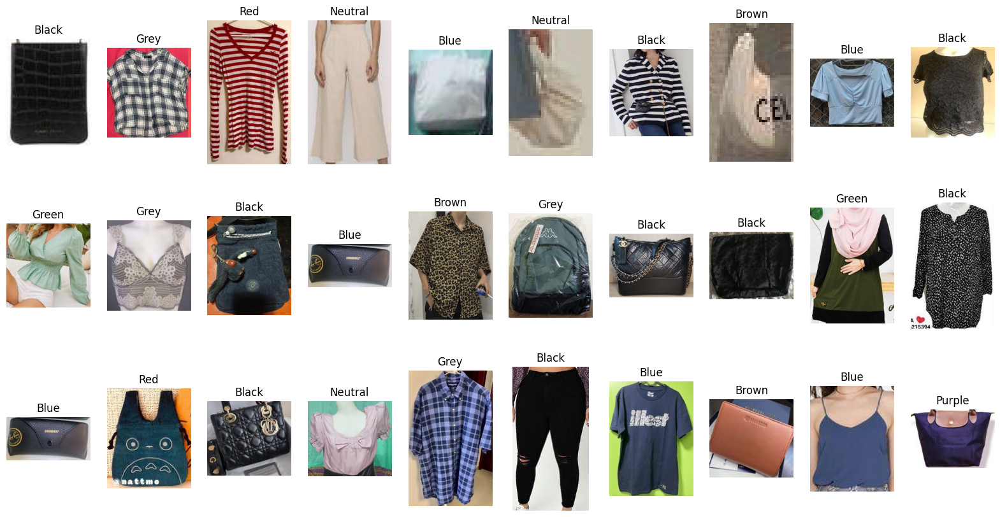

In [10]:
random.seed(31)
fig, ax = plt.subplots(3, 10, figsize=(20, 10))
for i in range(10):
    x = random.randint(0, len(data))
    y = random.randint(0, len(data))
    z = random.randint(0, len(data))
    img1 = data.iloc[x]['image_data_crop']
    img2 = data.iloc[y]['image_data_crop']
    img3 = data.iloc[z]['image_data_crop']
    ax[0, i].imshow(img1)
    ax[0, i].set_title(data.iloc[x]['Base Color'])
    ax[1, i].imshow(img2)
    ax[1, i].set_title(data.iloc[y]['Base Color'])
    ax[2, i].imshow(img3)
    ax[2, i].set_title(data.iloc[z]['Base Color'])
    ax[0, i].axis('off')
    ax[1, i].axis('off')
    ax[2, i].axis('off')
plt.show()

In [11]:
""" random.seed(31)
fig, ax = plt.subplots(3, 10, figsize=(20, 10))
for i in range(10):
    x = random.randint(0, len(data))
    y = random.randint(0, len(data))
    z = random.randint(0, len(data))
    img1 = data.iloc[x]['patch']
    img2 = data.iloc[y]['patch']
    img3 = data.iloc[z]['patch']
    ax[0, i].imshow(img1)
    ax[0, i].set_title(data.iloc[x]['Base Color'])
    ax[1, i].imshow(img2)
    ax[1, i].set_title(data.iloc[y]['Base Color'])
    ax[2, i].imshow(img3)
    ax[2, i].set_title(data.iloc[z]['Base Color'])
    ax[0, i].axis('off')
    ax[1, i].axis('off')
    ax[2, i].axis('off')
plt.show() """

" random.seed(31)\nfig, ax = plt.subplots(3, 10, figsize=(20, 10))\nfor i in range(10):\n    x = random.randint(0, len(data))\n    y = random.randint(0, len(data))\n    z = random.randint(0, len(data))\n    img1 = data.iloc[x]['patch']\n    img2 = data.iloc[y]['patch']\n    img3 = data.iloc[z]['patch']\n    ax[0, i].imshow(img1)\n    ax[0, i].set_title(data.iloc[x]['Base Color'])\n    ax[1, i].imshow(img2)\n    ax[1, i].set_title(data.iloc[y]['Base Color'])\n    ax[2, i].imshow(img3)\n    ax[2, i].set_title(data.iloc[z]['Base Color'])\n    ax[0, i].axis('off')\n    ax[1, i].axis('off')\n    ax[2, i].axis('off')\nplt.show() "

### Splitting the dataset into train,validation and testsets (70%-15%-15%)

In [12]:
from sklearn.model_selection import train_test_split

train_data, temp_data = train_test_split(data, test_size=0.3, random_state=31)
val_data, test_data = train_test_split(
    temp_data, test_size=0.5, random_state=1)

test_data = pd.read_pickle('test_data1.pkl')

""" test_data['index'] = range(len(test_data))
train_data['index'] = range(len(train_data))
val_data['index'] = range(len(val_data)) """

train_data['CAM']=None
val_data['CAM']=None
test_data['CAM']=None

print(train_data.shape)
print(val_data.shape)
print(test_data.shape)

(2844, 8)
(609, 8)
(610, 9)


In [13]:
""" import matplotlib.pyplot as plt
from ipywidgets import interact, widgets
from IPython.display import display, clear_output
import pandas as pd

base_colors = ["Red", "Blue", "Green", "Yellow", "Purple", "Orange", "Pink", "Neutral", "White", "Black", "Grey", "Brown"]


current_index = 0
output_image = widgets.Output()
base_color_dropdown = widgets.Dropdown(options=base_colors, description="Base Color:")
base_color_dropdown.value = test_data['Base Color'].iloc[current_index]
status_text = widgets.HTML(value="")

def display_image(index):
    plt.figure(figsize=(4, 4))
    image = test_data['image_data_crop'].iloc[index]
    color = test_data['Base Color'].iloc[index]
    image=Image.fromarray(image)
    image=transform(image)
    model.to('cpu')
    model.eval()
    features,output=model(image.unsqueeze(0))
    _, predicted = torch.max(output.data, 1)
    label = list(color_dict.keys())[list(color_dict.values()).index(predicted.item())]
    plt.imshow(image.permute(1, 2, 0))
    plt.axis('off')
    plt.title(test_data['Base Color'].iloc[index]+"\n"+label)
    
    with output_image:
        clear_output(wait=True)
        display(plt.gcf())

display_image(current_index)
status_text.value = f"Image {current_index+1} of {len(wrong_index)-1}"

def next_button_clicked(_):
    global current_index
    current_index = (current_index + 1) % len(wrong_index)
    display_image(wrong_index[current_index])
    status_text.value = f"Image {current_index+1} of {len(wrong_index)-1}"
    base_color_dropdown.value = test_data['Base Color'].iloc[wrong_index[current_index]]

def previous_button_clicked(_):
    global current_index
    current_index = (current_index - 1) % len(wrong_index)
    display_image(wrong_index[current_index])
    status_text.value = f"Image {current_index+1} of {len(wrong_index)-1}"
    base_color_dropdown.value = test_data['Base Color'].iloc[wrong_index[current_index]]

def base_color_dropdown_change(change):
    selected_color = str(change.new)
    test_data['Base Color'] = test_data['Base Color'].astype(str)
    test_data.iloc[wrong_index[current_index], test_data.columns.get_loc('Base Color')] = selected_color
    display_image(wrong_index[current_index])

previous_button = widgets.Button(description="Previous")
previous_button.on_click(previous_button_clicked)
next_button = widgets.Button(description="Next")
next_button.on_click(next_button_clicked)

base_color_dropdown.observe(base_color_dropdown_change, names='value')

display(status_text)
display(output_image)
display(base_color_dropdown)
display(previous_button)
display(next_button)
 """

' import matplotlib.pyplot as plt\nfrom ipywidgets import interact, widgets\nfrom IPython.display import display, clear_output\nimport pandas as pd\n\nbase_colors = ["Red", "Blue", "Green", "Yellow", "Purple", "Orange", "Pink", "Neutral", "White", "Black", "Grey", "Brown"]\n\n\ncurrent_index = 0\noutput_image = widgets.Output()\nbase_color_dropdown = widgets.Dropdown(options=base_colors, description="Base Color:")\nbase_color_dropdown.value = test_data[\'Base Color\'].iloc[current_index]\nstatus_text = widgets.HTML(value="")\n\ndef display_image(index):\n    plt.figure(figsize=(4, 4))\n    image = test_data[\'image_data_crop\'].iloc[index]\n    color = test_data[\'Base Color\'].iloc[index]\n    image=Image.fromarray(image)\n    image=transform(image)\n    model.to(\'cpu\')\n    model.eval()\n    features,output=model(image.unsqueeze(0))\n    _, predicted = torch.max(output.data, 1)\n    label = list(color_dict.keys())[list(color_dict.values()).index(predicted.item())]\n    plt.imshow(i

In [14]:
#test_data.to_pickle('test_data1.pkl')

### Upsampling miniority classes to match with the majority class

In [15]:
from sklearn.utils import resample

n = max(train_data['Base Color'].value_counts())

desired_sample_sizes = {
    'Black': 627,
    'Grey': 700,
    'White': 500,
    'Blue': 627,
    'Red': 627,
    'Green': 800,
    'Brown': 700,
    'Yellow': 627,
    'Pink': 827,
    'Purple': 1000,
    'Orange': 700,
    'Neutral': 827,
}

train_data_resampled = pd.DataFrame(columns=train_data.columns)
for color in desired_sample_sizes.keys():
    df = train_data[train_data['Base Color'] == color]
    df_resampled = resample(df, replace=True,
                            n_samples=desired_sample_sizes[color], random_state=1)
    train_data_resampled = pd.concat(
        [train_data_resampled, df_resampled], ignore_index=True)
    
print(train_data_resampled['Base Color'].value_counts())
#train_data=train_data_resampled

Base Color
Purple     1000
Pink        827
Neutral     827
Green       800
Grey        700
Brown       700
Orange      700
Black       627
Blue        627
Red         627
Yellow      627
White       500
Name: count, dtype: int64


In [16]:
color_dict = {}
for i, c in enumerate(set(data['Base Color'].unique())):
    color_dict[c] = i
print(color_dict)

{'White': 0, 'Yellow': 1, 'Neutral': 2, 'Red': 3, 'Black': 4, 'Blue': 5, 'Orange': 6, 'Green': 7, 'Grey': 8, 'Pink': 9, 'Purple': 10, 'Brown': 11}


### The Color Dataset

In [17]:
from torch.utils.data import Dataset, DataLoader

""" def normalize_color(image):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image[0,:,:] = cv2.equalizeHist(image[0,:,:])
    image = cv2.cvtColor(image, cv2.COLOR_HSV2RGB)
    return image

def remove(img):
    gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    contours = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)[0]
    max_contour = max(contours, key=cv2.contourArea)
    mask = np.zeros(img.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [max_contour], 0, 255, -1)
    result = img.copy()
    result[mask==0] = (255,255,255)
    return result """


class ColorDataset(Dataset):
    def __init__(self, data, colors, transform=None):
        self.data = data
        self.transform = transform
        self.color2idx = colors

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img = self.data.iloc[idx]['image_data_crop']
        cam = self.data.iloc[idx]['CAM']
        if cam is None:
            cam=Image.fromarray(img)
            cam = self.transform(cam)
        else:
            cam = Image.fromarray(cam)
            cam = self.transform(cam)
        img =Image.fromarray(img)
        img = self.transform(img)
        label = self.data.iloc[idx]['Base Color']
        label = self.color2idx[label]
        return img, label, cam

### Creating the dataloaders

In [18]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

train_dataset = ColorDataset(train_data,color_dict, transform=transform)
valid_dataset = ColorDataset(val_data,color_dict, transform=transform)
test_dataset = ColorDataset(test_data,color_dict, transform=transform)

batch=64

train_loader = DataLoader(train_dataset, batch_size=batch, shuffle=True, num_workers=3)
valid_loader = DataLoader(valid_dataset, batch_size=batch, shuffle=False, num_workers=3)
test_loader = DataLoader(test_dataset, batch_size=batch, shuffle=False, num_workers=3)

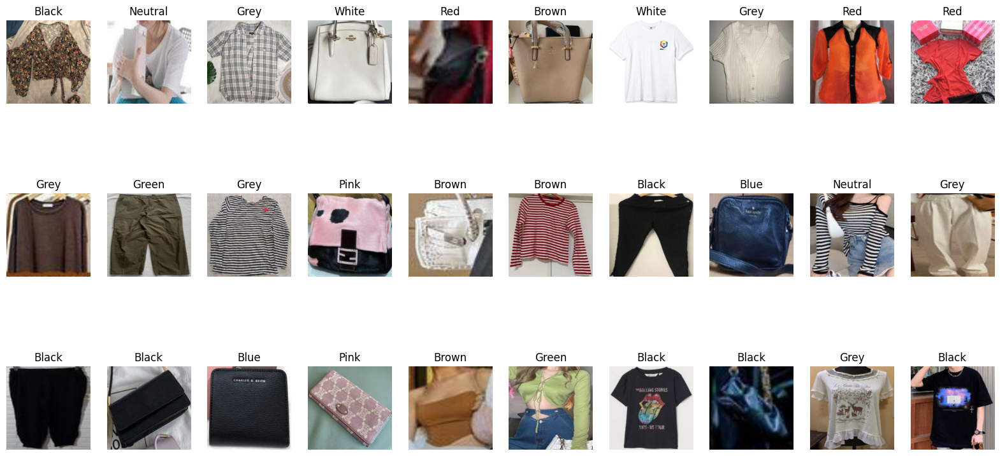

In [19]:
fig, ax = plt.subplots(3, 10, figsize=(20, 10))
for i, (img,label,cam) in enumerate(train_loader):
    if i >= 3:
        break
    for j in range(10):
        ax[i, j].imshow(img[j].permute(1, 2, 0))
        ax[i, j].set_title(list(color_dict.keys())[list(
            color_dict.values()).index(label[j].item())])
        ax[i, j].axis('off')
plt.show()

### Model Creation , Loss Function and Optimizers

In [20]:
""" import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau


class ColorClassifier(nn.Module):
    def __init__(self):
        super(ColorClassifier, self).__init__()
        
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1), # (256 - 4 + 2 * 1) / 2 + 1 = 128
            nn.MaxPool2d(kernel_size=4, stride=4), # (128 - 4) / 4 + 1 = 32
            nn.BatchNorm2d(64),
            nn.ReLU(),
        )
        
        self.conv2 = nn.Sequential(
            nn.Conv2d(64, 256, kernel_size=2, stride=2, padding=1), # (32 - 2 + 2 * 1) / 2 + 1 = 17
            nn.MaxPool2d(kernel_size=3, stride=3), # (17 - 3) / 3 + 1 = 5
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )

        self.conv3 = nn.Sequential(
            nn.Conv2d(256, 128, kernel_size=2, stride=1, padding=1), # (5 - 2 + 2 * 1) / 1 + 1 = 6
            nn.MaxPool2d(kernel_size=3, stride=1), # (6 - 3) / 1 + 1 = 4
            nn.BatchNorm2d(128),
            nn.ReLU(),
        )
        
        self.conv4 = nn.Sequential(
            nn.Conv2d(128, 512, kernel_size=2, stride=1, padding=1), # (4 - 2 + 2 * 1) / 1 + 1 = 5
            nn.MaxPool2d(kernel_size=2, stride=1), # (5 - 2) / 1 + 1 = 4
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Dropout(0.2),
        )
        
        self.fc1 = nn.Sequential(
            nn.Flatten(),
            nn.Linear(512 * 4 * 4, 512),
            nn.ReLU(),
        )
        
        self.fc2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
        )

        self.fc3 = nn.Sequential(
            nn.Linear(256, 12),
        )

        
    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x


model1 = ColorClassifier()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = ReduceLROnPlateau(optimizer, mode='min', patience=3, verbose=True) """

" import torch.nn as nn\nimport torch.optim as optim\nfrom torch.optim.lr_scheduler import ReduceLROnPlateau\n\n\nclass ColorClassifier(nn.Module):\n    def __init__(self):\n        super(ColorClassifier, self).__init__()\n        \n        self.conv1 = nn.Sequential(\n            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1), # (256 - 4 + 2 * 1) / 2 + 1 = 128\n            nn.MaxPool2d(kernel_size=4, stride=4), # (128 - 4) / 4 + 1 = 32\n            nn.BatchNorm2d(64),\n            nn.ReLU(),\n        )\n        \n        self.conv2 = nn.Sequential(\n            nn.Conv2d(64, 256, kernel_size=2, stride=2, padding=1), # (32 - 2 + 2 * 1) / 2 + 1 = 17\n            nn.MaxPool2d(kernel_size=3, stride=3), # (17 - 3) / 3 + 1 = 5\n            nn.BatchNorm2d(256),\n            nn.ReLU(),\n        )\n\n        self.conv3 = nn.Sequential(\n            nn.Conv2d(256, 128, kernel_size=2, stride=1, padding=1), # (5 - 2 + 2 * 1) / 1 + 1 = 6\n            nn.MaxPool2d(kernel_size=3, stride=1), # 

In [21]:
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, num_skip_connections=4):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.skip_connections = nn.ModuleList([nn.Sequential() for _ in range(num_skip_connections)])
        for i in range(num_skip_connections):
            if stride != 1 or in_channels != out_channels:
                self.skip_connections[i] = nn.Sequential(
                    nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                    nn.BatchNorm2d(out_channels)
                )
        
    def forward(self, x):
        residual = x
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        for skip_connection in self.skip_connections:
            out += skip_connection(residual)

        out = self.relu(out)
        return out

class ResNet(nn.Module):
    def __init__(self, block, layers, num_classes=12):
        super(ResNet, self).__init__()
        self.in_channels = 64
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.layer1 = self.make_layer(block, 64, layers[0])
        self.layer2 = self.make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self.make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self.make_layer(block, 1024, layers[3], stride=2)
        
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc1 = nn.Linear(1024, num_classes)
        self.fc2 = nn.Linear(2048, num_classes)
        self.dropout = nn.Dropout(0.2)  
        
    def make_layer(self, block, out_channels, blocks, stride=1):
        layers = []
        layers.append(block(self.in_channels, out_channels, stride))
        self.in_channels = out_channels
        for _ in range(1, blocks):
            layers.append(block(out_channels, out_channels))
        return nn.Sequential(*layers)
    
    def forward(self, x, cam=None):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        
        x = self.avgpool(x)
        features=x
        x = x.view(x.size(0), -1)
        if cam is not None:
            cam = self.conv1(cam)
            cam = self.bn1(cam)
            cam = self.relu(cam)
            cam = self.maxpool(cam)
            cam = self.layer1(cam)
            cam = self.layer2(cam)
            cam = self.layer3(cam)
            cam = self.layer4(cam)
            cam = self.avgpool(cam)
            cam = cam.view(cam.size(0), -1)
            x = torch.cat((x,cam),dim=1)
            output = self.fc2(x)
        else:
            output = self.fc1(x)
        return features,output

model = ResNet(ResidualBlock, [2,2,2,2], num_classes=12)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = ReduceLROnPlateau(optimizer, mode='min', patience=3, verbose=True)

In [22]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
criterion.to(device)

CrossEntropyLoss()

In [23]:
from torchsummary import summary
summary(model, (3, 256,256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           9,408
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
    ResidualBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

### Prediction for a single image by Untrained model

In [24]:
images ,labels,cam = next(iter(test_loader))
images,labels = images.to(device), labels.to(device)
features,output = model(images)
print(output[0])
_, preds = torch.max(output, 1)
print("Actual:", labels[0])
print("Predicted:", preds[0])

tensor([-0.1067,  2.9198, -3.8543,  2.3024, -1.2401,  1.2907,  1.9257, -2.4008,
        -1.6386,  0.7363, -2.1518,  0.6685], device='cuda:0',
       grad_fn=<SelectBackward0>)
Actual: tensor(2, device='cuda:0')
Predicted: tensor(1, device='cuda:0')


In [25]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

### Training Loop

In [26]:
import mlflow
epochs = 25
valid_loss_min = np.Inf
train_losses = []
valid_losses = []
train_accs = []
valid_accs = []
mlflow.set_experiment("Color_Classifier_crops")
with mlflow.start_run() as run:
    mlflow.log_param("epochs", epochs)
    mlflow.log_param("Learning Rate", 0.001)
    mlflow.log_param("scheduler", "ReduceLROnPlateau")
    mlflow.log_param("Optimizer", "Adam")
    mlflow.log_param("Loss Function", "CrossEntropyLoss")
    mlflow.log_param("Batch Size", batch)
    mlflow.log_param("Activation", "ReLU")
    for epoch in range(epochs):
        train_loss = 0
        valid_loss = 0
        train_acc = 0
        valid_acc = 0
        model.train()
        for images,labels,cam in train_loader:
            images,labels = images.to(device),labels.to(device)
            optimizer.zero_grad()
            features,output = model(images)
            loss = criterion(output, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()*images.size(0)
            _, preds = torch.max(output, 1)
            train_acc += torch.sum(preds == labels.data)
        model.eval()
        for images,labels,cam in valid_loader:
            images,labels = images.to(device), labels.to(device)
            features,output = model(images)
            loss = criterion(output, labels)
            valid_loss += loss.item()*images.size(0)
            _, preds = torch.max(output, 1)
            valid_acc += torch.sum(preds == labels.data)
        train_loss = train_loss/len(train_loader.dataset)
        valid_loss = valid_loss/len(valid_loader.dataset)
        train_acc = train_acc/len(train_loader.dataset)*100
        valid_acc = valid_acc/len(valid_loader.dataset)*100
        train_losses.append(train_loss)
        valid_losses.append(valid_loss)
        train_accs.append(train_acc.item())
        valid_accs.append(valid_acc.item())
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tTraining Accuracy: {:.6f} \tValidation Accuracy: {:.6f}'.format(
            epoch+1, train_loss, valid_loss, train_acc, valid_acc))
        mlflow.log_metric("train_loss", train_loss)
        mlflow.log_metric("valid_loss", valid_loss)
        mlflow.log_metric("train_acc", train_acc)
        mlflow.log_metric("valid_acc", valid_acc)
        writer.add_scalar('Loss/train', train_loss, epoch)
        writer.add_scalar('Loss/valid', valid_loss, epoch)
        writer.add_scalar('Accuracy/train', train_acc, epoch)
        writer.add_scalar('Accuracy/valid', valid_acc, epoch)
        if valid_loss < valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}). Saving model...'.format(
                valid_loss_min, valid_loss))
            torch.save(model.state_dict(), 'model.pt')
            valid_loss_min = valid_loss
        scheduler.step(valid_loss)
    mlflow.pytorch.log_model(model, "model")
    writer.add_graph(model, images)
    current_run_id = mlflow.active_run().info.run_id

Epoch: 1 	Training Loss: 2.656462 	Validation Loss: 1.686472 	Training Accuracy: 47.714485 	Validation Accuracy: 55.665024
Validation loss decreased (inf --> 1.686472). Saving model...
Epoch: 2 	Training Loss: 1.207292 	Validation Loss: 1.073131 	Training Accuracy: 62.517578 	Validation Accuracy: 64.532021
Validation loss decreased (1.686472 --> 1.073131). Saving model...
Epoch: 3 	Training Loss: 1.066604 	Validation Loss: 1.987762 	Training Accuracy: 65.084389 	Validation Accuracy: 49.917896
Epoch: 4 	Training Loss: 1.016503 	Validation Loss: 1.417971 	Training Accuracy: 66.596344 	Validation Accuracy: 55.172413


Epoch: 5 	Training Loss: 0.950306 	Validation Loss: 1.174310 	Training Accuracy: 67.791840 	Validation Accuracy: 62.233170
Epoch: 6 	Training Loss: 1.030427 	Validation Loss: 1.140203 	Training Accuracy: 65.963432 	Validation Accuracy: 64.696220
Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.
Epoch: 7 	Training Loss: 0.827868 	Validation Loss: 0.911682 	Training Accuracy: 72.081573 	Validation Accuracy: 70.607552
Validation loss decreased (1.073131 --> 0.911682). Saving model...
Epoch: 8 	Training Loss: 0.747526 	Validation Loss: 0.890720 	Training Accuracy: 73.593529 	Validation Accuracy: 70.443352
Validation loss decreased (0.911682 --> 0.890720). Saving model...
Epoch: 9 	Training Loss: 0.727566 	Validation Loss: 0.832951 	Training Accuracy: 73.839661 	Validation Accuracy: 73.234818
Validation loss decreased (0.890720 --> 0.832951). Saving model...
Epoch: 10 	Training Loss: 0.733548 	Validation Loss: 0.863772 	Training Accuracy: 73.980309 	Validation Accuracy: 71.59278

2023/11/29 11:08:28 WARNING mlflow.utils.requirements_utils: Found torch version (2.0.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.0.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.
2023/11/29 11:08:33 WARNING mlflow.utils.requirements_utils: Found torch version (2.0.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.0.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.
/home/cv/.virtualenvs/navaneeth/lib/python3.8/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")


In [27]:
def returnCAM(feature_conv, weight_softmax, class_idx):
    size_upsample = (256, 256)
    bz, nc, h, w = feature_conv.shape
    cam=weight_softmax[class_idx].dot(feature_conv.reshape((nc, h*w)))
    cam=cam.reshape(h, w)
    if np.max(cam) - np.min(cam) != 0:
        cam_img = (cam - np.min(cam)) / (np.max(cam) - np.min(cam))
    else:
        cam_img = cam / np.max(cam)
    cam_img=np.uint8(255 * cam_img)
    output_cam = cv2.resize(cam_img, size_upsample)
    return output_cam


def get_cam(img):
    img = cv2.resize(img, (256, 256))
    img = img.astype(np.float32) / 255
    img = np.transpose(img, (2, 0, 1))
    img = torch.from_numpy(img).float()
    img = img.unsqueeze(0).requires_grad_()
    img = img.to(device)
    model.eval()
    features,output = model(img)
    weight_softmax_params = list(model._modules.get('fc1').parameters())
    weight_softmax = np.squeeze(weight_softmax_params[0].cpu().data.numpy())
    _, predicted = torch.max(output.data, 1)
    label = list(color_dict.keys())[list(color_dict.values()).index(predicted.item())]
    cam = returnCAM(features.cpu().data.numpy(), weight_softmax, predicted.item())
    img = np.transpose(img.squeeze(0).cpu().data.numpy(), (1, 2, 0))
    img = img * 255
    img = img.astype(np.uint8)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img = cv2.applyColorMap(img,cv2.COLORMAP_JET)
    heatmap = cv2.applyColorMap(cv2.resize(cam,(256,256)), cv2.COLORMAP_JET)
    result = cv2.addWeighted(img, 0.9, heatmap, 0.1, 0)
    result = result.astype(np.uint8)
    return result,label


""" fig=plt.figure(figsize=(20, 60))
columns = 5
rows = 20
count = 0

for i in range(len(test_data)):
    img = test_data['image_data_crop'].iloc[i]
    img = cv2.resize(img, (256, 256))
    cam, label = get_cam(img)
    ground_truth = test_data['Base Color'].iloc[i]
    if label != ground_truth:
        count += 1
        fig.add_subplot(rows, columns, count)
        grid = np.concatenate((img, cam), axis=1)
        plt.imshow(grid)
        plt.axis('off')
        plt.title(f"True: {ground_truth}\nPredicted: {label}")
    if count == 100:
        break

plt.show() """

' fig=plt.figure(figsize=(20, 60))\ncolumns = 5\nrows = 20\ncount = 0\n\nfor i in range(len(test_data)):\n    img = test_data[\'image_data_crop\'].iloc[i]\n    img = cv2.resize(img, (256, 256))\n    cam, label = get_cam(img)\n    ground_truth = test_data[\'Base Color\'].iloc[i]\n    if label != ground_truth:\n        count += 1\n        fig.add_subplot(rows, columns, count)\n        grid = np.concatenate((img, cam), axis=1)\n        plt.imshow(grid)\n        plt.axis(\'off\')\n        plt.title(f"True: {ground_truth}\nPredicted: {label}")\n    if count == 100:\n        break\n\nplt.show() '

In [28]:
# create another column called CAM in train data , validation data and test data and store the CAM images in it

for i,row in train_data.iterrows():
    img=row['image_data_crop']
    cam,label=get_cam(img)
    train_data.at[i,'CAM']=cam

for i,row in val_data.iterrows():
    img=row['image_data_crop']
    cam,label=get_cam(img)
    val_data.at[i,'CAM']=cam

for i,row in test_data.iterrows():
    img=row['image_data_crop']
    cam,label=get_cam(img)
    test_data.at[i,'CAM']=cam

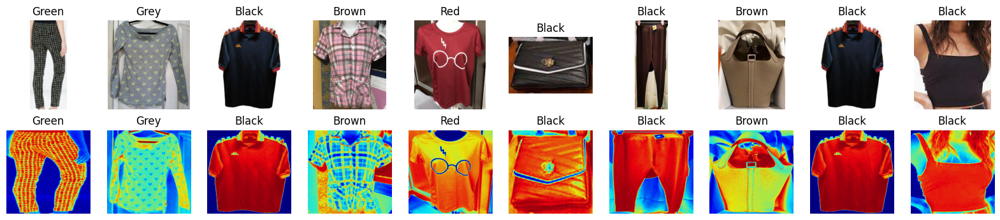

In [29]:
random.seed(31)
fig, ax = plt.subplots(2, 10, figsize=(20, 4))
for i in range(10):
    x = random.randint(0, len(train_data))
    img1 = train_data.iloc[x]['image_data_crop']
    img2 = train_data.iloc[x]['CAM']
    ax[0, i].imshow(img1)
    ax[0, i].set_title(train_data.iloc[x]['Base Color'])
    ax[1, i].imshow(img2)
    ax[1, i].set_title(train_data.iloc[x]['Base Color'])
    ax[0, i].axis('off')
    ax[1, i].axis('off')
plt.show()

In [30]:
train_dataset = ColorDataset(train_data,color_dict, transform=transform)
valid_dataset = ColorDataset(val_data,color_dict, transform=transform)
test_dataset = ColorDataset(test_data,color_dict, transform=transform)

batch=64

train_loader = DataLoader(train_dataset, batch_size=batch, shuffle=True, num_workers=3)
valid_loader = DataLoader(valid_dataset, batch_size=batch, shuffle=False, num_workers=3)
test_loader = DataLoader(test_dataset, batch_size=batch, shuffle=False, num_workers=3)

In [31]:
model1 = ResNet(ResidualBlock, [2,2,2,2], num_classes=12)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model1.parameters(), lr=0.00001)
scheduler = ReduceLROnPlateau(optimizer, mode='min', patience=3, verbose=True)
model1=nn.DataParallel(model1)
model1=model1.to(device)

In [32]:
images ,labels,cam = next(iter(test_loader))
images,labels,cam = images.to(device), labels.to(device),cam.to(device)
features,output = model1(images,cam)
print(output[0])
_, preds = torch.max(output, 1)
print("Actual:", labels[0])
print("Predicted:", preds[0])

tensor([-0.7404,  0.2137,  1.3573,  6.0566,  1.6116, -0.6936,  4.4544,  0.2391,
        -0.6259, -0.8176, -2.7492, -1.4106], device='cuda:0',
       grad_fn=<SelectBackward0>)
Actual: tensor(2, device='cuda:0')
Predicted: tensor(3, device='cuda:0')


In [33]:
epochs = 25
valid_loss_min = np.Inf
train_losses_cam = []
valid_losses_cam = []
train_accs_cam = []
valid_accs_cam = []

with mlflow.start_run(run_id=current_run_id) as run:
    mlflow.log_param("epochs_cam", epochs)
    mlflow.log_param("Learning Rate_cam", 0.00001)
    mlflow.log_param("scheduler_cam", "ReduceLROnPlateau")
    mlflow.log_param("Optimizer_cam", "Adam")
    mlflow.log_param("Loss Function_cam", "CrossEntropyLoss")
    mlflow.log_param("Batch Size_cam", batch)
    mlflow.log_param("Activation_cam", "ReLU")
    for epoch in range(epochs):
        train_loss = 0
        valid_loss = 0
        train_acc = 0
        valid_acc = 0
        model1.train()
        for images, labels, cam in train_loader:
            images, labels,cam = images.to(device), labels.to(device),cam.to(device)
            optimizer.zero_grad()
            features, output = model1(images,cam)
            loss = criterion(output, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * images.size(0)
            _, preds = torch.max(output, 1)
            train_acc += torch.sum(preds == labels.data)
        model1.eval()
        for images, labels, cam in valid_loader:
            images, labels,cam = images.to(device), labels.to(device),cam.to(device)
            features, output = model1(images,cam)
            loss = criterion(output, labels)
            valid_loss += loss.item() * images.size(0)
            _, preds = torch.max(output, 1)
            valid_acc += torch.sum(preds == labels.data)
        train_loss = train_loss / len(train_loader.dataset)
        valid_loss = valid_loss / len(valid_loader.dataset)
        train_acc = train_acc / len(train_loader.dataset) * 100
        valid_acc = valid_acc / len(valid_loader.dataset) * 100
        train_losses_cam.append(train_loss)
        valid_losses_cam.append(valid_loss)
        train_accs_cam.append(train_acc.item())
        valid_accs_cam.append(valid_acc.item())
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tTraining Accuracy: {:.6f} \tValidation Accuracy: {:.6f}'.format(
            epoch + 1, train_loss, valid_loss, train_acc, valid_acc))
        mlflow.log_metric("train_loss_cam", train_loss)
        mlflow.log_metric("valid_loss_cam", valid_loss)
        mlflow.log_metric("train_acc_cam", train_acc)
        mlflow.log_metric("valid_acc_cam", valid_acc)
        writer.add_scalar('Loss/train_cam', train_loss, epoch)
        writer.add_scalar('Loss/valid_cam', valid_loss, epoch)
        writer.add_scalar('Accuracy/train_cam', train_acc, epoch)
        writer.add_scalar('Accuracy/valid_cam', valid_acc, epoch)
        if valid_loss < valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}). Saving model...'.format(
                valid_loss_min, valid_loss))
            valid_loss_min = valid_loss
        scheduler.step(valid_loss)
    mlflow.pytorch.log_model(model1, "model_cam")

Epoch: 1 	Training Loss: 2.002320 	Validation Loss: 2.049246 	Training Accuracy: 47.046410 	Validation Accuracy: 43.842361
Validation loss decreased (inf --> 2.049246). Saving model...
Epoch: 2 	Training Loss: 1.016893 	Validation Loss: 2.364168 	Training Accuracy: 65.822784 	Validation Accuracy: 42.857143
Epoch: 3 	Training Loss: 0.867472 	Validation Loss: 2.299953 	Training Accuracy: 69.760902 	Validation Accuracy: 42.364532
Epoch: 4 	Training Loss: 0.782400 	Validation Loss: 2.506006 	Training Accuracy: 73.277077 	Validation Accuracy: 41.707718
Epoch: 5 	Training Loss: 0.724865 	Validation Loss: 2.591614 	Training Accuracy: 74.859352 	Validation Accuracy: 39.901478
Epoch 00005: reducing learning rate of group 0 to 1.0000e-06.
Epoch: 6 	Training Loss: 0.617160 	Validation Loss: 2.444235 	Training Accuracy: 78.938118 	Validation Accuracy: 42.692940


Epoch: 7 	Training Loss: 0.594968 	Validation Loss: 2.407891 	Training Accuracy: 80.344582 	Validation Accuracy: 41.379311
Epoch: 8 	Training Loss: 0.572676 	Validation Loss: 2.337779 	Training Accuracy: 81.891701 	Validation Accuracy: 43.021347
Epoch: 9 	Training Loss: 0.576450 	Validation Loss: 2.515076 	Training Accuracy: 80.555550 	Validation Accuracy: 42.528736
Epoch 00009: reducing learning rate of group 0 to 1.0000e-07.
Epoch: 10 	Training Loss: 0.551473 	Validation Loss: 2.531687 	Training Accuracy: 82.137833 	Validation Accuracy: 43.842361
Epoch: 11 	Training Loss: 0.558916 	Validation Loss: 2.507228 	Training Accuracy: 81.434593 	Validation Accuracy: 42.364532
Epoch: 12 	Training Loss: 0.547857 	Validation Loss: 2.495701 	Training Accuracy: 81.715897 	Validation Accuracy: 44.006569
Epoch: 13 	Training Loss: 0.565413 	Validation Loss: 2.327556 	Training Accuracy: 81.223625 	Validation Accuracy: 43.842361
Epoch 00013: reducing learning rate of group 0 to 1.0000e-08.
Epoch: 14 	

2023/11/29 11:14:57 WARNING mlflow.utils.requirements_utils: Found torch version (2.0.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.0.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.
2023/11/29 11:15:01 WARNING mlflow.utils.requirements_utils: Found torch version (2.0.1+cu118) contains a local version label (+cu118). MLflow logged a pip requirement for this package as 'torch==2.0.1' without the local version label to make it installable from PyPI. To specify pip requirements containing local version labels, please use `conda_env` or `pip_requirements`.


### Test Accuracy

In [34]:
#model.load_state_dict(torch.load('model.pt'))
#torch.save(model.state_dict(), 'model1.pt')
with mlflow.start_run(run_id=current_run_id):
    model.eval()
    wrong=0
    test_acc = 0
    for images,labels,cam in test_loader:
        images,labels = images.to(device), labels.to(device)
        features,output = model(images)
        _, preds = torch.max(output, 1)
        test_acc += torch.sum(preds == labels.data)
        wrong += torch.sum(preds != labels.data)
    test_acc = test_acc/len(test_loader.dataset)*100
    mlflow.log_metric("test_acc", test_acc)
    print("Test Accuracy: {:.6f}".format(test_acc))
    print("Wrong Predictions: ", wrong.item())
    print("Total Predictions: ", len(test_loader.dataset))

Test Accuracy: 89.344261
Wrong Predictions:  65
Total Predictions:  610


In [35]:
#model.load_state_dict(torch.load('model.pt'))
#torch.save(model.state_dict(), 'model1.pt')
with mlflow.start_run(run_id=current_run_id):
    model1.eval()
    wrong=0
    test_acc = 0
    for images,labels,cam in test_loader:
        images,labels,cam = images.to(device), labels.to(device),cam.to(device)
        features,output = model1(images,cam)
        _, preds = torch.max(output, 1)
        test_acc += torch.sum(preds == labels.data)
        wrong += torch.sum(preds != labels.data)
    test_acc = test_acc/len(test_loader.dataset)*100
    mlflow.log_metric("test_acc_cam", test_acc)
    print("Test Accuracy: {:.6f}".format(test_acc))
    print("Wrong Predictions: ", wrong.item())
    print("Total Predictions: ", len(test_loader.dataset))

Test Accuracy: 49.344261
Wrong Predictions:  309
Total Predictions:  610


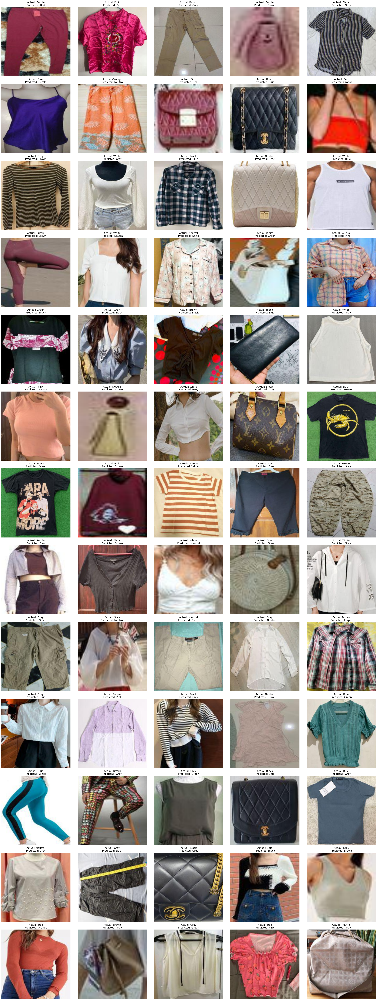

[]


In [36]:
model.eval()
wrong_images = []
wrong_labels = []
wrong_index = []

for images,labels,cam in test_loader:
    images,labels = images.to(device), labels.to(device)
    features,output = model(images)
    _, preds = torch.max(output, 1)
    for j in range(len(labels)):
        if preds[j] != labels[j]:
            wrong_images.append(images[j])
            wrong_labels.append((labels[j].item(), preds[j].item()))


num_wrong_images = len(wrong_images)
num_cols = 5 
num_rows = (num_wrong_images + num_cols - 1) // num_cols
fig, ax = plt.subplots(num_rows, num_cols, figsize=(6 * num_cols, 6 * num_rows))
for i, (image, (actual_label, predicted_label)) in enumerate(zip(wrong_images, wrong_labels)):
    row, col = divmod(i, num_cols)
    ax[row, col].imshow(image.cpu().permute(1, 2, 0))
    ax[row, col].set_title("Actual: {}\nPredicted: {}".format(
        list(color_dict.keys())[list(color_dict.values()).index(actual_label)],
        list(color_dict.keys())[list(color_dict.values()).index(predicted_label)]),fontsize=14)
    ax[row, col].axis('off')

plt.tight_layout()
plt.show()

print(wrong_index)

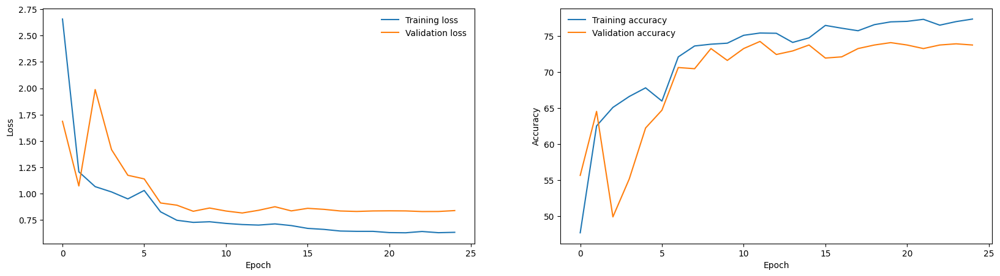

In [37]:
fig = plt.figure(figsize=(20, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(frameon=False)
plt.subplot(1, 2, 2)
plt.plot(train_accs, label='Training accuracy')
plt.plot(valid_accs, label='Validation accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(frameon=False)
plt.show()

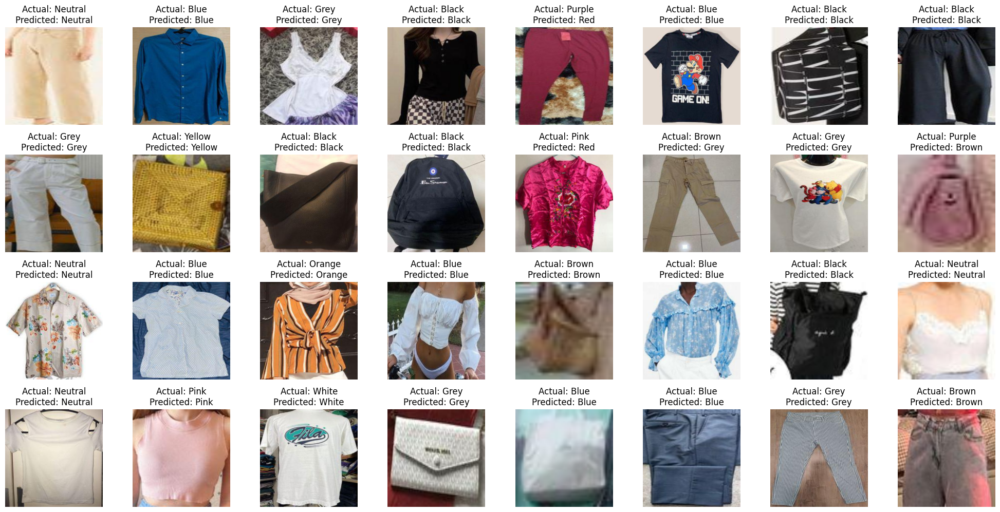

In [38]:
images,labels,cam = next(iter(test_loader))
images, labels = images.to(device), labels.to(device)
features,output = model(images)
_, preds = torch.max(output, 1)
fig = plt.figure(figsize=(20, 20))
for i in range(32):
    ax = plt.subplot(8, 8, i+1)
    ax.imshow(images[i].permute(1, 2, 0).cpu())
    ax.set_title("Actual: {}\nPredicted: {}".format(
        list(color_dict.keys())[
            list(color_dict.values()).index(labels[i].item())],
        list(color_dict.keys())[
            list(color_dict.values()).index(preds[i].item())]
    ))
    ax.axis('off')
plt.tight_layout()
plt.show()

In [39]:
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix

model.to(device)
model.eval()
y_pred = []
y_true = []
for images,labels,cam in test_loader:
    images,labels = images.to(device), labels.to(device)
    features,output = model(images)
    _, preds = torch.max(output, 1)
    y_pred.extend(preds.tolist())
    y_true.extend(labels.tolist())
print("F1 Score: {:.6f}".format(f1_score(y_true, y_pred, average='weighted')))
print("Precision: {:.6f}".format(
    precision_score(y_true, y_pred, average='weighted')))
print("Recall: {:.6f}".format(recall_score(
    y_true, y_pred, average='weighted')))
print("Confusion Matrix:")
print(confusion_matrix(y_true, y_pred))

F1 Score: 0.893139
Precision: 0.895984
Recall: 0.893443
Confusion Matrix:
[[ 18   0   2   0   0   1   0   1   4   0   0   0]
 [  0   2   0   0   0   0   0   0   0   0   0   0]
 [  1   0  44   0   0   0   0   1   3   1   0   2]
 [  0   0   0  21   0   0   2   0   0   1   0   0]
 [  0   0   0   0 147   4   0   2   3   0   0   1]
 [  1   0   0   0   1  77   0   1   1   0   1   0]
 [  0   1   1   0   0   0   5   0   0   0   0   0]
 [  0   0   0   0   1   0   0  33   1   0   0   0]
 [  0   0   2   0   2   2   0   4 103   0   0   2]
 [  0   0   0   2   0   0   1   0   0  16   0   1]
 [  0   0   0   1   0   0   0   0   0   2  10   2]
 [  0   0   0   0   1   0   0   0   4   0   1  69]]


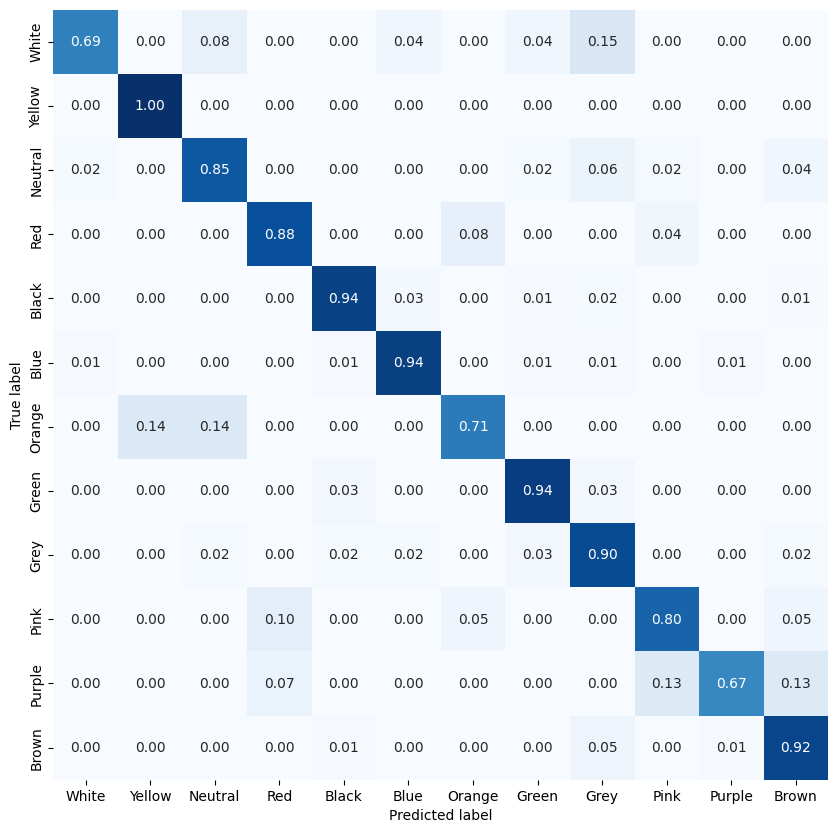

In [40]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

cm = confusion_matrix(y_true, y_pred)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
df_cm = pd.DataFrame(cm, index=list(color_dict.keys()),
                     columns=list(color_dict.keys()))
plt.figure(figsize=(10, 10))
sns.heatmap(df_cm, annot=True, cmap='Blues', fmt='.2f', cbar=False)
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [41]:
writer.close()

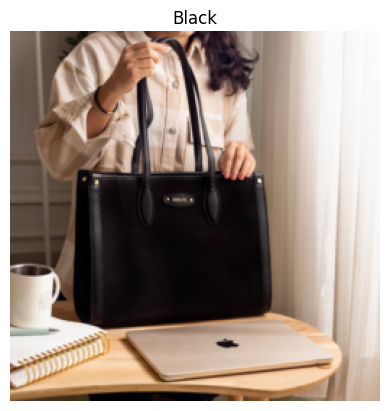

In [42]:
model.to(device)
model.eval()
url='https://www.themessycorner.in/cdn/shop/products/07_800x.jpg?v=1680598271'
r=requests.get(url)
image1=Image.open(BytesIO(r.content))
image=transform(image1)
image=image.unsqueeze(0)
image=image.to(device)
features,output=model(image)
_,preds=torch.max(output,1)
plt.imshow(image.cpu().squeeze().permute(1,2,0))
plt.title(list(color_dict.keys())[list(color_dict.values()).index(preds.item())])
plt.axis('off')
plt.show()

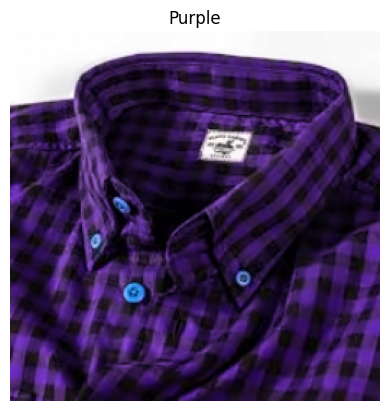

In [43]:
model.to(device)
model.eval()
url='https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSmPXDcEnm1fwxtf54vfb6vIIMDYouM52AUQA&usqp=CAU'
r=requests.get(url)
image1=Image.open(BytesIO(r.content))
image1=np.array(image1)
image1=cv2.fastNlMeansDenoisingColored(image1,None,10,10,7,21)
image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)
image1=Image.fromarray(image1)
image=transform(image1)
image=image.unsqueeze(0)
image=image.to(device)
features,output=model(image)
_,preds=torch.max(output,1)
plt.imshow(image.cpu().squeeze().permute(1,2,0))
plt.title(list(color_dict.keys())[list(color_dict.values()).index(preds.item())])
plt.axis('off')
plt.show()

In [44]:
""" from lang_sam import LangSAM
from lang_sam.utils import draw_image

model1 = LangSAM()
url='https://media.istockphoto.com/id/470950404/photo/happy-male-traveler-walking-with-bags-and-cellphone.jpg?s=612x612&w=0&k=20&c=CvwxnAGhbiwEqHH5H8EOPODnm1E2OoCVYk2Q6kg2J4E='
r=requests.get(url)
image_pil=Image.open(BytesIO(r.content))
image_pil=image_pil.convert('RGB')
text_prompt = 'bag'
masks, boxes, labels, logits = model1.predict(image_pil, text_prompt)
image_pil=np.array(image_pil)
image1 = draw_image(image_pil, masks, boxes, labels)
boxes=boxes.tolist()
x1,y1,x2,y2=boxes[0]
image=Image.fromarray(image_pil)
image=image.crop((x1,y1,x2,y2))
plt.imshow(image) """

" from lang_sam import LangSAM\nfrom lang_sam.utils import draw_image\n\nmodel1 = LangSAM()\nurl='https://media.istockphoto.com/id/470950404/photo/happy-male-traveler-walking-with-bags-and-cellphone.jpg?s=612x612&w=0&k=20&c=CvwxnAGhbiwEqHH5H8EOPODnm1E2OoCVYk2Q6kg2J4E='\nr=requests.get(url)\nimage_pil=Image.open(BytesIO(r.content))\nimage_pil=image_pil.convert('RGB')\ntext_prompt = 'bag'\nmasks, boxes, labels, logits = model1.predict(image_pil, text_prompt)\nimage_pil=np.array(image_pil)\nimage1 = draw_image(image_pil, masks, boxes, labels)\nboxes=boxes.tolist()\nx1,y1,x2,y2=boxes[0]\nimage=Image.fromarray(image_pil)\nimage=image.crop((x1,y1,x2,y2))\nplt.imshow(image) "